<a href="https://colab.research.google.com/github/yuktaX/CityAQVis/blob/main/CityAQVis_Dataset_ML_Model.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [4]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [5]:
pip install git+https://github.com/stevenpawley/Pyspatialml

  Cloning https://github.com/stevenpawley/Pyspatialml to /tmp/pip-req-build-0gpw3g4n
  Running command git clone --filter=blob:none --quiet https://github.com/stevenpawley/Pyspatialml /tmp/pip-req-build-0gpw3g4n
  Resolved https://github.com/stevenpawley/Pyspatialml to commit 95008f7ef945b2a8beb9a858348437b941646b9f
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 8.6/8.6 MB 49.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 22.2/22.2 MB 56.0 MB/s eta 0:00:00
  Created wheel for pyspatialml: filename=pyspatialml-0.22.1-py3-none-any.whl size=70041 sha256=a615f2160fd583e50b086b03c5d7624a00b315427bee3e84c8a26f826fb8fa1a
  Stored in directory: /tmp/pip-ephem-wheel-cache-i02yt4z_/wheels/f4/44/e4/bb744d592cfa6fdc2d38402824a098b2efcb14ad03c25d3059
Successfully built pyspatialml
  Attempting uninstall: matplotlib
    Found existing installation: matpl

In [6]:
# Import used packages
import geopandas as gpd  # used to read the shapfile
import rasterio as rio   # used to read the raster (.tif) files
from rasterio.plot import show # used to make plots using rasterio
import matplotlib.pyplot as plt #to make plots using matplotlib
import seaborn as sns
import os
import pandas as pd

# Dataset Preparation

1. Choose the city, pollutant and year of study
2. Upload the station locations file which contain UTMY UTMX coordinates
3. Initialize the driving factors
4. Add raster files for the driving factors from external sources (eg. GEE)
5. A file called "new_points.csv" will be generated which contains the stations and remote driving factors for each month.

### 1. Choosing pollutant and year

In [7]:
pollutant = "NO2"
year = 2019
city = "blr"

### 2. Adding station locations

In [8]:
#reading station points
points = gpd.read_file(f'/content/drive/MyDrive/DownloadTest/{city}/stations.shp')

In [9]:
points

,ID,NAME,UTMX,UTMY,geometry
0,1,Silk Board,784605,1429452,POINT (784605 1429452)
1,2,BTM Layout,781598,1428998,POINT (781598 1428998)
2,3,Jayanagar 5th Block,780485,1429813,POINT (780485 1429813)
3,4,Hombegowda Nagar,781029,1431762,POINT (781029 1431762)
4,5,RVCE-Mailasandra,771534,1429772,POINT (771534 1429772)
5,6,Bapuji Nagar,775552,1433187,POINT (775552 1433187)
6,7,City Railway Station,778380,1435847,POINT (778380 1435847)
7,8,Sanegurava Halli,775874,1437443,POINT (775874 1437443)
8,9,Shivapura_Peenya,772024,1441202,POINT (772024 1441202)
9,10,Peenya,770511,1441451,POINT (770511 1441451)


### 3. Initialize driving factors

In [1]:
# Define a function to extract raster values for a given point from a TIFF file
def extract_raster_values(point, raster_file):
    longitude = point['geometry'].x
    latitude = point['geometry'].y
    with rio.open(raster_file) as src:
        row, col = src.index(longitude, latitude)
        value = src.read(1)[row, col]  # Assuming single band raster
    return value

In [10]:
#Driving factors

points[pollutant] = None
points['Elevation'] = None
points['Rainfall'] = None
points['Population'] = None
points['VIIRS'] = None
# points['LandUse'] = None
points['Temperature'] = None
points['WindSpeed'] = None
points['DSSR'] = None

### 4. Add driving factor raster files

In [30]:
#Initializing files for monthly averages

months = ['01', '02', '03', '04', '05', '06', '07', '08', '09', '10', '11', '12']
no2_raster_files = [f'/content/drive/MyDrive/DownloadTest/{city}/no2_{year}/no2_{month}.tif' for month in months]
rainfall_raster_files = [f'/content/drive/MyDrive/DownloadTest/{city}/rainfall_{year}/rainfall_{month}.tif' for month in months]
viirs_raster_files = [f'/content/drive/MyDrive/DownloadTest/{city}/viirs_{year}/viirs_{month}.tif' for month in months]
wind_raster_files = [f'/content/drive/MyDrive/DownloadTest/{city}/windspeed_{year}/windspeed_{month}.tif' for month in months]
temp_raster_files = [f'/content/drive/MyDrive/DownloadTest/{city}/temperature_{year}/temp_{month}.tif' for month in months]
dssr_raster_files = [f'/content/drive/MyDrive/DownloadTest/{city}/dssr_{year}/dssr_{month}.tif' for month in months]

print(len(dssr_raster_files))

12


In [24]:
#Initializing files for annual averages

Elevation_raster = rio.open(f'/content/drive/MyDrive/DownloadTest/{city}/elevationTest1.tif')
Elevation_arr = Elevation_raster.read(1)

Pop_raster = rio.open(f'/content/drive/MyDrive/DownloadTest/{city}/populationTest1.tif')
Pop_arr = Pop_raster.read(1)


# Rainfall_raster = rio.open(f'/content/drive/MyDrive/DownloadTest/{city}/rainTest1.tif')
# Rainfall_arr = Rainfall_raster.read(1)

# # Landuse_raster = rio.open('/content/drive/MyDrive/DownloadTest/categoricalUse.tif')
# # Landuse_arr = Landuse_raster.read(1)

# NO2_raster = rio.open(f'/content/drive/MyDrive/DownloadTest/{city}/no2Test2.tif')
# NO2_arr = NO2_raster.read(1)

In [28]:
#Extracting the raster values to the points shapefile
#dummy points df
count=0

for index,row in points.iterrows(): #iterate over the points in the shapefile
    longitude=row['geometry'].x #get the longitude of the point
    latitude=row['geometry'].y  #get the latitude of the point

    rowIndex, colIndex = NO2_raster.index(longitude,latitude) # the corresponding pixel to the point (longitude,latitude)

    # Extract the raster values at the point location

    points['Elevation'].loc[index] = Elevation_arr[rowIndex, colIndex]
    points['Population'].loc[index] = Pop_arr[rowIndex, colIndex]

    # points['NO2'].loc[index] = NO2_arr[rowIndex, colIndex]
    # points['Rainfall'].loc[index] = Rainfall_arr[rowIndex, colIndex]
    # points['LandUse'].loc[index] = Landuse_arr[rowIndex, colIndex]
    # points['VIIRS'].loc[index] = Rainfall_arr[rowIndex, colIndex]

points


<ipython-input-28-e39e158609f4>:13: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  points['Elevation'].loc[index] = Elevation_arr[rowIndex, colIndex]
<ipython-input-28-e39e158609f4>:13: SettingWithCopyWarning: 
A value is trying to be set on 

,ID,NAME,UTMX,UTMY,geometry,NO2,Elevation,Rainfall,Population,VIIRS,Temperature,WindSpeed,DSSR
0,1,Silk Board,784605,1429452,POINT (784605 1429452),0.000094,899,0.096829,311.084717,None,None,None,None
1,2,BTM Layout,781598,1428998,POINT (781598 1428998),0.000097,918,0.105698,311.084717,None,None,None,None
2,3,Jayanagar 5th Block,780485,1429813,POINT (780485 1429813),0.000097,918,0.105698,311.084717,None,None,None,None
3,4,Hombegowda Nagar,781029,1431762,POINT (781029 1431762),0.000101,911,0.105698,4442.861328,None,None,None,None
4,5,RVCE-Mailasandra,771534,1429772,POINT (771534 1429772),0.000091,813,0.105698,311.084686,None,None,None,None
5,6,Bapuji Nagar,775552,1433187,POINT (775552 1433187),0.0001,844,0.105698,5448.823242,None,None,None,None
6,7,City Railway Station,778380,1435847,POINT (778380 1435847),0.000103,889,0.105698,9186.900391,None,None,None,None
7,8,Sanegurava Halli,775874,1437443,POINT (775874 1437443),0.0001,897,0.105698,9186.283203,None,None,None,None
8,9,Shivapura_Peenya,772024,1441202,POINT (772024 1441202),0.000092,906,0.10142,9185.048828,None,None,None,None
9,10,Peenya,770511,1441451,POINT (770511 1441451),0.000088,876,0.1071,9185.049805,None,None,None,None


### 5. Generating dataset

In [29]:
new_rows = []

for _, point in points.iterrows():
    for month, no2_file, rainfall_file, viirs_file, temp_file, wind_file, dssr_file in zip(months, no2_raster_files, rainfall_raster_files, viirs_raster_files, temp_raster_files, wind_raster_files, dssr_raster_files):
        no2_value = extract_raster_values(point, no2_file)
        rainfall_value = extract_raster_values(point, rainfall_file)
        viirs_value = extract_raster_values(point, viirs_file)
        temp_value = extract_raster_values(point, temp_file)
        wind_value = extract_raster_values(point, wind_file)
        dssr_value = extract_raster_values(point, dssr_file)
        new_row = {
            'geometry': point['geometry'],
            'NAME': point['NAME'],
            'NO2': no2_value,
            'Elevation': point['Elevation'],
            'Rainfall': rainfall_value,
            'Population': point['Population'],
            'VIIRS':viirs_value,
            # 'LandUse': point['LandUse'],
            'Temperature':temp_value,
            'WindSpeed':wind_value,
            'DSSR': dssr_value
        }
        new_rows.append(new_row)

new_points = gpd.GeoDataFrame(new_rows, crs=points.crs)
new_points

,geometry,NAME,NO2,Elevation,Rainfall,Population,VIIRS,Temperature,WindSpeed,DSSR
0,POINT (784605 1429452),Silk Board,0.000109,899,0.029407,311.084717,72.517502,283.0,160.0,NaN
1,POINT (784605 1429452),Silk Board,0.000112,899,0.006970,311.084717,65.619995,322.0,150.0,NaN
2,POINT (784605 1429452),Silk Board,0.000130,899,0.002326,311.084717,65.463127,356.0,170.0,NaN
3,POINT (784605 1429452),Silk Board,0.000118,899,0.062593,311.084717,60.801876,357.0,210.0,NaN
4,POINT (784605 1429452),Silk Board,0.000126,899,0.360507,311.084717,52.906250,347.0,190.0,NaN
...,...,...,...,...,...,...,...,...,...,...
151,POINT (790951 1431495),BWSSB Kadabesanahalli,0.000060,884,0.147316,199.990570,19.211876,287.0,290.0,NaN
152,POINT (790951 1431495),BWSSB Kadabesanahalli,0.000069,884,0.156623,199.990570,20.636875,294.0,190.0,NaN
153,POINT (790951 1431495),BWSSB Kadabesanahalli,0.000069,884,0.139792,199.990570,20.538124,290.0,130.0,NaN
154,POINT (790951 1431495),BWSSB Kadabesanahalli,0.000063,884,0.009620,199.990570,23.463125,288.0,150.0,NaN


In [ ]:
# new_points = pd.get_dummies(new_points, columns = ['LandUse'])
# new_points

In [ ]:
csv_filename = 'new_points_' + city + str(year) + '.csv'
new_points.to_csv(csv_filename, index=False)

# Adding ground data

Manually add the ground data values to corresponding rows in the *new_points* dataset generated above and upload it

In [ ]:
df=pd.read_csv(f"/content/drive/MyDrive/DownloadTest/{city}/with_ground(in)_{year}.csv", encoding = 'unicode_escape')
df

,geometry,NAME,NO2,Elevation,Rainfall,Population,VIIRS,Temperature,WindSpeed,Monthly_avg_ground_data (µg/m³),Month
0,POINT (705105.737 3190171.961),Narela,0.000139,213,29,2620.3167,11.371875,205,30,40.265806,Jan
1,POINT (705105.737 3190171.961),Narela,0.000154,213,22,2620.3167,11.139375,232,40,51.555714,Feb
2,POINT (705105.737 3190171.961),Narela,0.000120,213,9,2620.3167,12.226250,285,160,44.890645,March
3,POINT (705105.737 3190171.961),Narela,0.000123,213,15,2620.3167,13.023750,369,120,51.375667,April
4,POINT (705105.737 3190171.961),Narela,0.000136,213,4,2620.3167,12.764376,397,270,43.730645,May
...,...,...,...,...,...,...,...,...,...,...,...
295,POINT (717675.0432 3171987.673),Chandni Chowk,0.000123,216,239,14762.5470,38.498750,347,180,NaN,Aug
296,POINT (717675.0432 3171987.673),Chandni Chowk,0.000145,216,109,14762.5470,42.450626,347,230,NaN,Sep
297,POINT (717675.0432 3171987.673),Chandni Chowk,0.000180,216,11,14762.5470,49.426872,334,40,NaN,Oct
298,POINT (717675.0432 3171987.673),Chandni Chowk,0.000215,216,23,14762.5470,41.783127,299,90,NaN,Nov


In [ ]:
# df = points

In [ ]:
df.columns.tolist()

['geometry',
 'NAME',
 'NO2',
 'Elevation',
 'Rainfall',
 'Population',
 'VIIRS',
 'Temperature',
 'WindSpeed',
 'Monthly_avg_ground_data (µg/m³)',
 'Month']

# EDA and Preprocessing

In [ ]:
df = df.dropna()

In [ ]:
print(df.isnull().sum())

geometry                           0
NAME                               0
NO2                                0
Elevation                          0
Rainfall                           0
Population                         0
VIIRS                              0
Temperature                        0
WindSpeed                          0
Monthly_avg_ground_data (µg/m³)    0
Month                              0
dtype: int64


In [ ]:
df

,geometry,NAME,NO2,Elevation,Rainfall,Population,VIIRS,Temperature,WindSpeed,Monthly_avg_ground_data (µg/m³),Month
0,POINT (705105.737 3190171.961),Narela,0.000139,213,29,2620.3167,11.371875,205,30,40.265806,Jan
1,POINT (705105.737 3190171.961),Narela,0.000154,213,22,2620.3167,11.139375,232,40,51.555714,Feb
2,POINT (705105.737 3190171.961),Narela,0.000120,213,9,2620.3167,12.226250,285,160,44.890645,March
3,POINT (705105.737 3190171.961),Narela,0.000123,213,15,2620.3167,13.023750,369,120,51.375667,April
4,POINT (705105.737 3190171.961),Narela,0.000136,213,4,2620.3167,12.764376,397,270,43.730645,May
...,...,...,...,...,...,...,...,...,...,...,...
283,POINT (719737.9907 3177985.922),Sonia Vihar,0.000116,209,252,9356.8910,19.357500,346,200,20.544516,Aug
284,POINT (719737.9907 3177985.922),Sonia Vihar,0.000133,209,103,9356.8910,18.916250,348,250,15.948333,Sep
285,POINT (719737.9907 3177985.922),Sonia Vihar,0.000154,209,11,9356.8910,24.073124,333,40,31.221935,Oct
286,POINT (719737.9907 3177985.922),Sonia Vihar,0.000186,209,22,9356.8910,25.668125,296,90,47.184667,Nov


<Axes: >

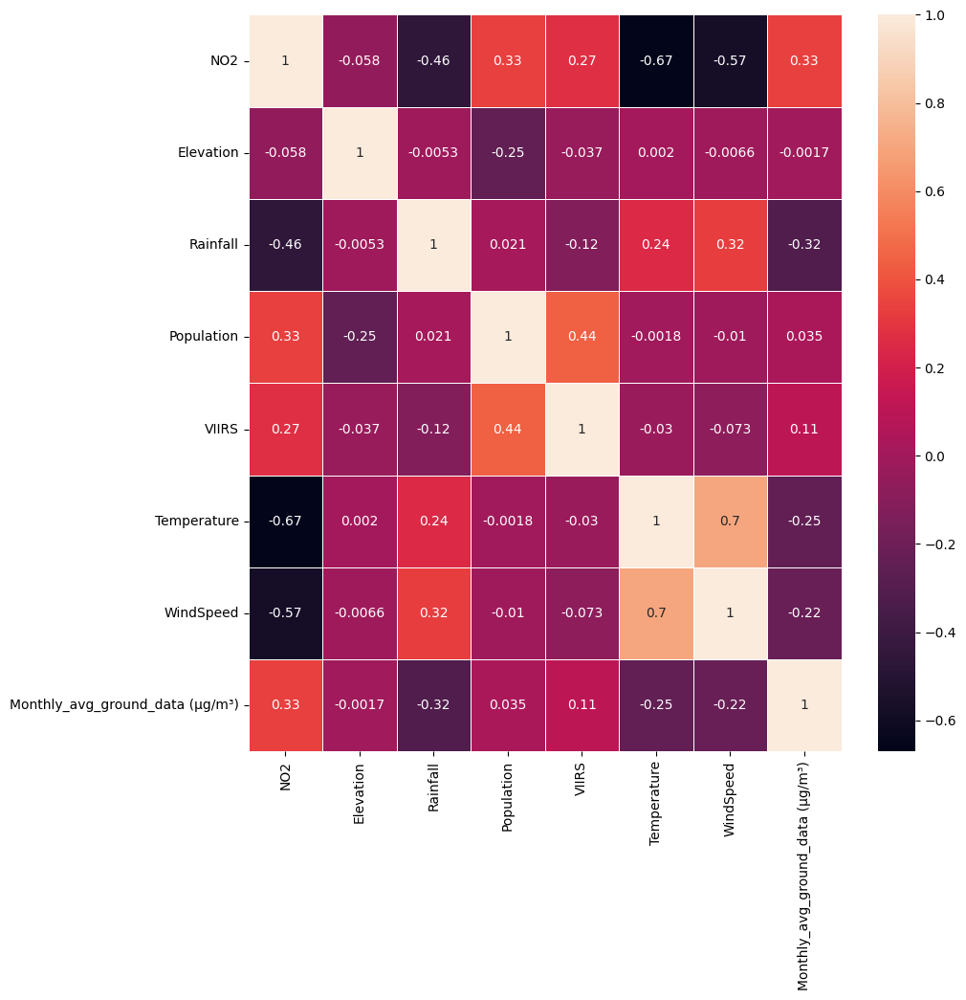

In [ ]:
# show the correlation matric for the dataset
df_tmp = df.drop(columns = ['geometry', 'NAME','Month'], axis = 1)
corrMatrix = df_tmp.corr()
fig, ax = plt.subplots(figsize=(10,10))

sns.heatmap(corrMatrix, annot=True, linewidths=.5, ax=ax)

In [ ]:
# @title NO2 vs Elevation

# from matplotlib import pyplot as plt

# df.plot(kind='scatter', x='Monthly_avg_ground_data (µg/m³)', y='NO2 (mol/m^2)', s=32, alpha=.8)

# plt.figure(figsize=(20, 20))

### VIIRS vs Ground Data

In [ ]:
# df.plot(kind='scatter', x='Monthly_avg_ground_data (µg/m³)', y='VIIRS', s=32, alpha=.8)

# plt.figure(figsize=(20, 20))

# Training Models

We will now run some ML models on this data to generate predictions.

#### Train Test Split

In [ ]:
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.metrics import r2_score
from sklearn.metrics import mean_squared_error
from sklearn.metrics import mean_absolute_error
import numpy as np


# Reshape the input data to be 2D arrays
y = df['Monthly_avg_ground_data (µg/m³)']
# x = df.drop(columns=['Monthly_avg_ground_data (µg/m³)',"NAME", "geometry", "Month", "LandUse_0", "LandUse_3", "LandUse_13", "LandUse_14", "LandUse_15", "LandUse_24"])
x = df.drop(columns=['Monthly_avg_ground_data (µg/m³)',"NAME", "geometry", "Month"])

# Split the data into training and testing sets
# x_train, x_test, y_train, y_test = train_test_split(x, y, train_size=0.7, random_state = 31)
x_train, x_test, y_train, y_test = train_test_split(x, y, train_size=0.7, random_state = 33)

#defining function for evaluation
def mean_absolute_percentage_error(y_true, y_pred):
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

In [ ]:
x_train

,NO2,Elevation,Rainfall,Population,VIIRS,Temperature,WindSpeed
174,0.000128,216,222,9942.6610,48.099373,358,130
271,0.000120,227,233,9944.2360,35.995625,346,190
87,0.000162,218,22,20750.4550,48.098747,370,140
70,0.000227,208,22,9195.8260,37.093124,298,100
134,0.000172,225,11,19265.9840,44.116875,288,160
...,...,...,...,...,...,...,...
201,0.000179,256,12,3675.2327,45.956875,334,40
146,0.000203,220,11,22232.6860,81.553120,287,160
66,0.000130,208,232,9195.8260,34.341250,358,160
216,0.000225,219,27,3780.2744,40.981873,208,20


#### Random Forest

In [ ]:
from sklearn.model_selection import GridSearchCV
#Random forest with hyperparameter tuning using GridSearch

from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import r2_score

np.random.seed(45)

# Define the parameter grid
param_grid = {
    'n_estimators': [15, 25, 50, 75, 100],
    'max_depth': [4, 6, 8],
    'min_samples_split': [2, 5, 10, 12],
    'min_samples_leaf': [1, 2, 4]
}

# Initialize the Random Forest Regressor
rfr = RandomForestRegressor()

# Create the GridSearchCV object
grid_search = GridSearchCV(rfr, param_grid, cv=2)

# Train the model with hyperparameter tuning
grid_search.fit(x_train, y_train)

# Get the best model with tuned hyperparameters
best_model = grid_search.best_estimator_

# Make predictions using the best model
y_pred = best_model.predict(x_test)


# Calculate the R^2 score
r2 = r2_score(y_test, y_pred)
print("R^2 Score:", r2)

mae = mean_absolute_error(y_test, y_pred)
print("Mean Absolute Error (MAE):", mae)

mse = mean_squared_error(y_test, y_pred)
print("Mean Squared Error (MSE):", mse)

mape = mean_absolute_percentage_error(y_test, y_pred)
print("Mean Absolute Percentage Error (MAPE):", mape)

rmse = mean_squared_error(y_test, y_pred, squared=False)
print("Root Mean Squared Error (RMSE):" , rmse)

R^2 Score: 0.4097317304663254
Mean Absolute Error (MAE): 12.709022342123497
Mean Squared Error (MSE): 289.3539823196645
Mean Absolute Percentage Error (MAPE): 38.44062236925828
Root Mean Squared Error (RMSE): 17.010408058587675


/usr/local/lib/python3.10/dist-packages/numpy/ma/core.py:2820: RuntimeWarning: invalid value encountered in cast
  _data = np.array(data, dtype=dtype, copy=copy,
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


#### Linear Regression

In [ ]:
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline

np.random.seed(45)

# Define the parameter grid for Linear Regression
param_grid = {
    'linear__fit_intercept': [True, False]
}

# Create a pipeline that includes scaling and the linear regression model
pipeline = Pipeline([
    ('scaler', StandardScaler()),  # You can remove this if you don't want to scale features
    ('linear', LinearRegression())
])

# Create the GridSearchCV object
grid_search = GridSearchCV(pipeline, param_grid, cv=2)

# Train the model with hyperparameter tuning
grid_search.fit(x_train, y_train)

# Get the best model with tuned hyperparameters
best_model = grid_search.best_estimator_

# Make predictions using the best model
y_pred = best_model.predict(x_test)

# Calculate the R^2 score
r2 = r2_score(y_test, y_pred)
print("R^2 Score:", r2)

# Calculate additional evaluation metrics
mae = mean_absolute_error(y_test, y_pred)
print("Mean Absolute Error (MAE):", mae)

mse = mean_squared_error(y_test, y_pred)
print("Mean Squared Error (MSE):", mse)

mape = mean_absolute_percentage_error(y_test, y_pred)
print("Mean Absolute Percentage Error (MAPE):", mape)

rmse = mean_squared_error(y_test, y_pred, squared=False)
print("Root Mean Squared Error (RMSE):", rmse)

R^2 Score: 0.18973486913882498
Mean Absolute Error (MAE): 15.169900798484045
Mean Squared Error (MSE): 397.1981121984901
Mean Absolute Percentage Error (MAPE): 47.95692224489006
Root Mean Squared Error (RMSE): 19.929829708216026


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


#### SVM

In [ ]:
from sklearn.svm import SVR
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline

np.random.seed(45)

# Define the parameter grid for SVR
param_grid = {
    'svr__C': [0.1, 1, 10, 100],
    'svr__epsilon': [0.01, 0.1, 0.2],
    'svr__kernel': ['linear', 'rbf', 'poly'],
    'svr__gamma': ['scale', 'auto']  # Only relevant for 'rbf' and 'poly' kernels
}

# Create a pipeline that includes scaling and the SVR model
pipeline = Pipeline([
    ('scaler', StandardScaler()),  # SVR performs better with scaled features
    ('svr', SVR())
])

# Create the GridSearchCV object
grid_search = GridSearchCV(pipeline, param_grid, cv=2)

# Train the model with hyperparameter tuning
grid_search.fit(x_train, y_train)

# Get the best model with tuned hyperparameters
best_model = grid_search.best_estimator_

# Make predictions using the best model
y_pred = best_model.predict(x_test)

# Calculate the R^2 score
r2 = r2_score(y_test, y_pred)
print("R^2 Score:", r2)

# Calculate additional evaluation metrics
mae = mean_absolute_error(y_test, y_pred)
print("Mean Absolute Error (MAE):", mae)

mse = mean_squared_error(y_test, y_pred)
print("Mean Squared Error (MSE):", mse)

mape = mean_absolute_percentage_error(y_test, y_pred)
print("Mean Absolute Percentage Error (MAPE):", mape)

rmse = mean_squared_error(y_test, y_pred, squared=False)
print("Root Mean Squared Error (RMSE):", rmse)

R^2 Score: 0.3083563613481025
Mean Absolute Error (MAE): 13.645970102029372
Mean Squared Error (MSE): 339.04895709216544
Mean Absolute Percentage Error (MAPE): 39.439602160805784
Root Mean Squared Error (RMSE): 18.4132820836527


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


#### Gradient Boosting Regressor

In [ ]:
#Gradient Boosting regressor with hyperparameter tuning using GridSearch

np.random.seed(29)

# Define the parameter grid
param_grid = {
    'n_estimators': [25, 50, 100, 200],
    'learning_rate': [0.1, 0.01, 0.001],
    'max_depth': [3, 5, 8, 12, 16]
}

# Initialize the Gradient Boosting Regressor
gbr = GradientBoostingRegressor()

# Create the GridSearchCV object
grid_search = GridSearchCV(gbr, param_grid, cv=2)

# Train the model with hyperparameter tuning
grid_search.fit(x_train, y_train)

# Get the best model with tuned hyperparameters
best_model = grid_search.best_estimator_

# Make predictions using the best model
y_pred = best_model.predict(x_test)

# Calculate the R^2 score
r2 = r2_score(y_test, y_pred)
print("R^2 Score:", r2)

mae = mean_absolute_error(y_test, y_pred)
print("Mean Absolute Error (MAE):", mae)

mse = mean_squared_error(y_test, y_pred)
print("Mean Squared Error (MSE):", mse)

mape = mean_absolute_percentage_error(y_test, y_pred)
print("Mean Absolute Percentage Error (MAPE):", mape)

rmse = mean_squared_error(y_test, y_pred, squared=False)
print("Root Mean Squared Error (RMSE):" , rmse)

R^2 Score: 0.3620334346457267
Mean Absolute Error (MAE): 13.314244547156033
Mean Squared Error (MSE): 312.7360486747733
Mean Absolute Percentage Error (MAPE): 39.9504142005107
Root Mean Squared Error (RMSE): 17.684344734108


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


# Visualizing predictions for the entire city

### Grid Creation

In [ ]:
import numpy as np
import pandas as pd
from pyproj import Proj, transform

# Define the boundaries of the city in lat and lon
lat_min, lat_max = 12.85, 13.20  # Example for a city like Bangalore
lon_min, lon_max = 77.45, 77.80

# Define the grid resolution (distance between points in degrees)
grid_size = 0.001  # Adjust as needed

# Create the grid points
lat_grid = np.arange(lat_min, lat_max, grid_size)
lon_grid = np.arange(lon_min, lon_max, grid_size)
grid_points = [(lat, lon) for lat in lat_grid for lon in lon_grid]

# Define the projection: WGS84 (lat/lon) to UTM (Zone 43N, for example)
proj_wgs84 = Proj(proj='latlong', datum='WGS84')
proj_utm = Proj(proj='utm', zone=43, datum='WGS84')

# Convert grid points to UTM coordinates and keep lat/lon
utm_grid_points = [(lat, lon, *transform(proj_wgs84, proj_utm, lon, lat)) for lat, lon in grid_points]

# Convert to DataFrame and round the UTM coordinates to the nearest integer
grid_df = pd.DataFrame(utm_grid_points, columns=['latitude', 'longitude', 'UTMX', 'UTMY'])
grid_df[['UTMX', 'UTMY']] = grid_df[['UTMX', 'UTMY']].round(0).astype(int)

grid_df

<ipython-input-30-388c6f5b11e5>:22: FutureWarning: This function is deprecated. See: https://pyproj4.github.io/pyproj/stable/gotchas.html#upgrading-to-pyproj-2-from-pyproj-1
  utm_grid_points = [(lat, lon, *transform(proj_wgs84, proj_utm, lon, lat)) for lat, lon in grid_points]


,latitude,longitude,UTMX,UTMY
0,12.850,77.450,765914,1421813
1,12.850,77.451,766022,1421814
2,12.850,77.452,766131,1421815
3,12.850,77.453,766239,1421816
4,12.850,77.454,766348,1421817
...,...,...,...,...
122495,13.199,77.795,802959,1460831
122496,13.199,77.796,803067,1460832
122497,13.199,77.797,803176,1460833
122498,13.199,77.798,803284,1460834


In [ ]:
grid_df['NO2'] = None
grid_df['Elevation'] = None
grid_df['Rainfall'] = None
grid_df['Population'] = None
grid_df['VIIRS'] = None
# grid_df['LandUse'] = None
grid_df['Temperature'] = None
grid_df['WindSpeed'] = None
grid_df

,latitude,longitude,UTMX,UTMY,NO2,Elevation,Rainfall,Population,VIIRS,Temperature,WindSpeed
0,12.850,77.450,765914,1421813,None,None,None,None,None,None,None
1,12.850,77.451,766022,1421814,None,None,None,None,None,None,None
2,12.850,77.452,766131,1421815,None,None,None,None,None,None,None
3,12.850,77.453,766239,1421816,None,None,None,None,None,None,None
4,12.850,77.454,766348,1421817,None,None,None,None,None,None,None
...,...,...,...,...,...,...,...,...,...,...,...
122495,13.199,77.795,802959,1460831,None,None,None,None,None,None,None
122496,13.199,77.796,803067,1460832,None,None,None,None,None,None,None
122497,13.199,77.797,803176,1460833,None,None,None,None,None,None,None
122498,13.199,77.798,803284,1460834,None,None,None,None,None,None,None


In [ ]:
import warnings
warnings.filterwarnings('ignore')

In [ ]:
# months = ['01', '02', '03', '04', '05', '06', '07', '08', '09', '10', '11', '12']
# no2_raster_files = [f'/content/drive/MyDrive/DownloadTest/no2_{month}.tif' for month in months]
# rainfall_raster_files = [f'/content/drive/MyDrive/DownloadTest/rainfall_{month}.tif' for month in months]
# viirs_raster_files = [f'/content/drive/MyDrive/DownloadTest/viirs_{month}.tif' for month in months]
# wind_raster_files = [f'/content/drive/MyDrive/DownloadTest/windspeed_{month}.tif' for month in months]
# temp_raster_files = [f'/content/drive/MyDrive/DownloadTest/temp_{month}.tif' for month in months]

NO2_raster = rio.open('/content/drive/MyDrive/DownloadTest/NO2_blr.tif')
NO2_arr = NO2_raster.read(1)

Elevation_raster = rio.open('/content/drive/MyDrive/DownloadTest/elevation_blr.tif')
Elevation_arr = Elevation_raster.read(1)

Rainfall_raster = rio.open('/content/drive/MyDrive/DownloadTest/rainfall_blr.tif')
Rainfall_arr = Rainfall_raster.read(1)

Pop_raster = rio.open('/content/drive/MyDrive/DownloadTest/population_blr.tif')
Pop_arr = Pop_raster.read(1)

Viirs_raster = rio.open('/content/drive/MyDrive/DownloadTest/viirs_blr.tif')
Viirs_arr = Viirs_raster.read(1)

Temperature_raster = rio.open('/content/drive/MyDrive/DownloadTest/temperature_blr.tif')
Temperature_arr = Temperature_raster.read(1)

Windspeed_raster = rio.open('/content/drive/MyDrive/DownloadTest/wind_blr.tif')
Windspeed_arr = Windspeed_raster.read(1)

# Landuse_raster = rio.open('/content/drive/MyDrive/DownloadTest/categoricalUse.tif')
# Landuse_arr = Landuse_raster.read(1)

#Extracting the raster values to the points shapefile
count=0

for index,row in grid_df.iterrows(): #iterate over the points in the shapefile
    longitude=row['UTMX'] #get the longitude of the point
    latitude=row['UTMY']  #get the latitude of the point

    rowIndex, colIndex = NO2_raster.index(longitude,latitude) # the corresponding pixel to the point (longitude,latitude)

    # Extract the raster values at the point location
    grid_df['NO2'].loc[index] = NO2_arr[rowIndex, colIndex]
    grid_df['Elevation'].loc[index] = Elevation_arr[rowIndex, colIndex]
    grid_df['Population'].loc[index] = Pop_arr[rowIndex, colIndex]
    grid_df['Rainfall'].loc[index] = Rainfall_arr[rowIndex, colIndex]
    grid_df['VIIRS'].loc[index] = Viirs_arr[rowIndex, colIndex]
    grid_df['Temperature'].loc[index] = Temperature_arr[rowIndex, colIndex]
    grid_df['WindSpeed'].loc[index] = Windspeed_arr[rowIndex, colIndex]
    # points['LandUse'].loc[index] = Landuse_arr[rowIndex, colIndex]
    #points['VIIRS'].loc[index] = Rainfall_arr[rowIndex, colIndex]


In [ ]:
grid_df

,latitude,longitude,UTMX,UTMY,NO2,Elevation,Rainfall,Population,VIIRS,Temperature,WindSpeed
0,12.850,77.450,765914,1421813,0.000068,752,76.25,311.188202,4.271927,315.333333,195.0
1,12.850,77.451,766022,1421814,0.000068,752,76.25,311.188202,4.271927,315.333333,195.0
2,12.850,77.452,766131,1421815,0.000068,752,76.25,311.188202,4.271927,315.333333,195.0
3,12.850,77.453,766239,1421816,0.000068,752,76.25,311.188202,4.271927,315.333333,195.0
4,12.850,77.454,766348,1421817,0.000068,752,76.25,311.188202,4.271927,315.333333,195.0
...,...,...,...,...,...,...,...,...,...,...,...
122495,13.199,77.795,802959,1460831,NaN,0,NaN,NaN,NaN,NaN,NaN
122496,13.199,77.796,803067,1460832,NaN,0,NaN,NaN,NaN,NaN,NaN
122497,13.199,77.797,803176,1460833,NaN,0,NaN,NaN,NaN,NaN,NaN
122498,13.199,77.798,803284,1460834,NaN,0,NaN,NaN,NaN,NaN,NaN


In [ ]:
null_percentage = grid_df.isnull().mean() * 100
print(null_percentage)

latitude       0.000000
longitude      0.000000
UTMX           0.000000
UTMY           0.000000
NO2            4.364898
Elevation      0.000000
Rainfall       4.364898
Population     4.364898
VIIRS          4.364898
Temperature    4.364898
WindSpeed      4.364898
dtype: float64


In [ ]:
# Assuming df is your DataFrame
grid_df = grid_df.dropna()
grid_df

,latitude,longitude,UTMX,UTMY,NO2,Elevation,Rainfall,Population,VIIRS,Temperature,WindSpeed
0,12.850,77.450,765914,1421813,0.000068,752,76.25,311.188202,4.271927,315.333333,195.0
1,12.850,77.451,766022,1421814,0.000068,752,76.25,311.188202,4.271927,315.333333,195.0
2,12.850,77.452,766131,1421815,0.000068,752,76.25,311.188202,4.271927,315.333333,195.0
3,12.850,77.453,766239,1421816,0.000068,752,76.25,311.188202,4.271927,315.333333,195.0
4,12.850,77.454,766348,1421817,0.000068,752,76.25,311.188202,4.271927,315.333333,195.0
...,...,...,...,...,...,...,...,...,...,...,...
122445,13.199,77.745,797535,1460771,0.000063,889,72.166667,373.039642,12.065,309.0,200.0
122446,13.199,77.746,797644,1460772,0.000063,889,72.166667,373.039642,12.065,309.0,200.0
122447,13.199,77.747,797752,1460773,0.000063,889,72.166667,373.039642,12.065,309.0,200.0
122448,13.199,77.748,797861,1460774,0.000063,889,72.166667,373.039642,12.065,309.0,200.0


In [ ]:
# pip install earthengine-api

In [ ]:
# import ee
# ee.Authenticate()  # Run this only once to authenticate

In [ ]:
# ee.Initialize(project='ee-brijdesai2003')

In [ ]:
# no2_dataset = ee.ImageCollection('COPERNICUS/S5P/OFFL/L3_NO2') \
#               .filterDate('2023-01-01', '2023-01-31') \
#               .select('tropospheric_NO2_column_number_density') \
#               .mean()  # Get the average for the month

# elevation_dataset = ee.Image('CGIAR/SRTM90_V4')

# rainfall_dataset = ee.ImageCollection("IDAHO_EPSCOR/TERRACLIMATE") \
#                   .filterDate('2023-01-01', '2023-01-31') \
#                   .select('pr') \
#                   .mean()

# population_dataset = ee.ImageCollection("CIESIN/GPWv411/GPW_Population_Count") \
#                         .filterDate('2020-01-01', '2020-12-31') \
#                         .mean()

# viirs_dataset = ee.ImageCollection('NOAA/VIIRS/DNB/MONTHLY_V1/VCMCFG') \
#                         .filterDate('2023-01-01', '2023-01-31') \
#                         .select('avg_rad') \
#                         .mean()

# # landuse_dataset = ee.Image("JRC/GHSL/P2023A/GHS_BUILT_C/2018")

# temperature_dataset = ee.ImageCollection("IDAHO_EPSCOR/TERRACLIMATE") \
#                   .filterDate('2023-01-01', '2023-01-31') \
#                   .select('tmmx') \
#                   .mean()

# windspeed_dataset = ee.ImageCollection("IDAHO_EPSCOR/TERRACLIMATE") \
#                   .filterDate('2023-01-01', '2023-01-31') \
#                   .select('vs') \
#                   .mean()

In [ ]:
# # Define a function to get data from Earth Engine for a single point
# def get_ee_data(lat, lon):
#     point = ee.Geometry.Point(lon, lat)

#     # Get NO2 data from TROPOMI
#     no2_value = no2_dataset.reduceRegion(
#         reducer=ee.Reducer.mean(),
#         geometry=point,
#         scale=3000
#     ).get('tropospheric_NO2_column_number_density').getInfo()

#     # Example: Get Elevation data
#     elevation_value = elevation_dataset.reduceRegion(
#         reducer=ee.Reducer.mean(),
#         geometry=point,
#         scale=3000
#     ).get('elevation').getInfo()

#     # Get Rainfall data from TerraClimate
#     rainfall_value = rainfall_dataset.reduceRegion(
#         reducer=ee.Reducer.mean(),
#         geometry=point,
#         scale=3000
#     ).get('pr').getInfo()

#     # Get Population data from CIESIN

#     population_value = population_dataset.reduceRegion(
#         reducer=ee.Reducer.mean(),
#         geometry=point,
#         scale=3000
#     ).get('population_count').getInfo()

#     # Get VIIRS Nighttime Lights data
#     viirs_value = viirs_dataset.reduceRegion(
#         reducer=ee.Reducer.mean(),
#         geometry=point,
#         scale=3000
#     ).get('avg_rad').getInfo()

#      # Get Land Use data from GHS Built-Up Grid
#     # landuse_value = landuse_dataset.reduceRegion(
#     #     reducer=ee.Reducer.mean(),
#     #     geometry=point,
#     #     scale=1000
#     # ).get('built_characteristics').getInfo()

#     temperature_value = temperature_dataset.reduceRegion(
#         reducer=ee.Reducer.mean(),
#         geometry=point,
#         scale=3000
#     ).get('tmmx').getInfo()

#     windspeed_value = windspeed_dataset.reduceRegion(
#         reducer=ee.Reducer.mean(),
#         geometry=point,
#         scale=3000
#     ).get('vs').getInfo()

#     return no2_value, elevation_value, rainfall_value, population_value, viirs_value, temperature_value, windspeed_value

#     # Add other data sources similarly...

In [ ]:
# temp = grid_df.head(3)
# temp

In [ ]:
# # Apply the function to all grid points
# temp[['Tropomi_NO2', 'Elevation', 'Rainfall', 'Population', 'viirs', 'Temperature', 'Windspeed']] = temp.apply(lambda row: get_ee_data(row['latitude'], row['longitude']), axis=1, result_type='expand')
# temp

In [ ]:
# grid_df[['NO2 (mol/m^2)', 'Elevation', 'Rainfall', 'Population', 'VIIRS', 'Temperature', 'WindSpeed']] = grid_df.apply(lambda row: get_ee_data(row['latitude'], row['longitude']), axis=1, result_type='expand')

In [ ]:
# csv_filename = 'new_blr.csv'
# grid_df.to_csv(csv_filename, index=False)

In [ ]:
# Assuming df is your DataFrame and you want to rename 'old_column' to 'new_column'
grid_df.rename(columns={'NO2': 'NO2 (mol/m^2)'}, inplace=True)

In [ ]:
grid_df.head()

,latitude,longitude,UTMX,UTMY,NO2 (mol/m^2),Elevation,Rainfall,Population,VIIRS,Temperature,WindSpeed
0,12.85,77.450,765914,1421813,0.000068,752,76.25,311.188202,4.271927,315.333333,195.0
1,12.85,77.451,766022,1421814,0.000068,752,76.25,311.188202,4.271927,315.333333,195.0
2,12.85,77.452,766131,1421815,0.000068,752,76.25,311.188202,4.271927,315.333333,195.0
3,12.85,77.453,766239,1421816,0.000068,752,76.25,311.188202,4.271927,315.333333,195.0
4,12.85,77.454,766348,1421817,0.000068,752,76.25,311.188202,4.271927,315.333333,195.0


In [ ]:
features = ['NO2 (mol/m^2)', 'Elevation', 'Rainfall', 'Population', 'VIIRS', 'Temperature', 'WindSpeed']
grid_df['NO2_prediction'] = best_model.predict(grid_df[features])

In [ ]:
grid_df.head()

,latitude,longitude,UTMX,UTMY,NO2 (mol/m^2),Elevation,Rainfall,Population,VIIRS,Temperature,WindSpeed,NO2_prediction
0,12.85,77.450,765914,1421813,0.000068,752,76.25,311.188202,4.271927,315.333333,195.0,25.335969
1,12.85,77.451,766022,1421814,0.000068,752,76.25,311.188202,4.271927,315.333333,195.0,25.335969
2,12.85,77.452,766131,1421815,0.000068,752,76.25,311.188202,4.271927,315.333333,195.0,25.335969
3,12.85,77.453,766239,1421816,0.000068,752,76.25,311.188202,4.271927,315.333333,195.0,25.335969
4,12.85,77.454,766348,1421817,0.000068,752,76.25,311.188202,4.271927,315.333333,195.0,25.335969


In [ ]:
import folium
from folium.plugins import HeatMap

# Create a base map centered around the city
m = folium.Map(location=[(lat_min + lat_max) / 2, (lon_min + lon_max) / 2], zoom_start=12)

# Convert predictions to a list of [latitude, longitude, NO2] for HeatMap
heat_data = [[row['latitude'], row['longitude'], row['NO2_prediction']] for index, row in grid_df.iterrows()]

# Add the heatmap layer
HeatMap(heat_data, radius=15).add_to(m)

# Save map to HTML file or display directly
m.save('no2_heatmap.html')
m

In [ ]:
import folium
from folium.plugins import HeatMap

# Create a base map centered around the city
m = folium.Map(location=[(lat_min + lat_max) / 2, (lon_min + lon_max) / 2], zoom_start=12)

# Convert predictions to a list of [latitude, longitude, NO2] for HeatMap
heat_data = [[row['latitude'], row['longitude'], row['NO2_prediction']] for index, row in grid_df.iterrows()]

# Add the heatmap layer with NO2 predictions
HeatMap(heat_data, radius=20, blur=25, max_zoom=12, min_opacity=0.4).add_to(m)

# HTML for the custom legend
legend_html = '''
<div style="
    position: fixed;
    bottom: 50px; left: 50px; width: 150px; height: 150px;
    background-color: white; border:2px solid grey; z-index:9999; font-size:14px;
    padding: 0px;
    ">
    <b>NO2 Levels</b><br>
    <i style="background: rgba(0, 0, 255, 0.5);width: 20px;height: 10px;display: inline-block;"></i> Low (<10 μg/m³)<br>
    <i style="background: rgba(0, 255, 0, 0.5);width: 20px;height: 10px;display: inline-block;"></i> Moderate (10-20 μg/m³)<br>
    <i style="background: rgba(255, 255, 0, 0.5);width: 20px;height: 10px;display: inline-block;"></i> High (20-40 μg/m³)<br>
    <i style="background: rgba(255, 0, 0, 0.5);width: 20px;height: 10px;display: inline-block;"></i> Very High (>40 μg/m³)
</div>
'''

# Add the custom legend to the map
m.get_root().html.add_child(folium.Element(legend_html))

# Save the map to an HTML file or display directly
m.save('no2_heatmap_with_legend.html')
m


In [ ]:
import plotly.express as px

# Prepare data for Plotly
df = grid_df[['latitude', 'longitude', 'NO2_prediction']]

# Create a scatter mapbox plot with a color scale for NO2 predictions
fig = px.scatter_mapbox(df, lat='latitude', lon='longitude',
                        color='NO2_prediction',
                        color_continuous_scale='Viridis',
                        mapbox_style='open-street-map',
                        zoom=12)

# Customize the map
fig.update_layout(mapbox_center={"lat": (lat_min + lat_max) / 2, "lon": (lon_min + lon_max) / 2})

# Display the map
fig.show()


### Kernel Density Estimation

In [ ]:
from sklearn.neighbors import KernelDensity
from scipy.stats import gaussian_kde

# Assuming your DataFrame is already loaded as grid_df

# Extract the latitude, longitude, and NO2_prediction columns
coords = grid_df[['latitude', 'longitude']].values
no2_values = grid_df['NO2_prediction'].values

# Define the bandwidth for the KDE
bandwidth = 0.01  # You can experiment with this value for smoothing

# Fit a KDE model using the latitude and longitude data
kde = KernelDensity(bandwidth=bandwidth, kernel='gaussian')
kde.fit(coords, sample_weight=no2_values)

# Create a grid of points over the map (adjust the step size for smoother results)
lat_min, lat_max = grid_df['latitude'].min(), grid_df['latitude'].max()
lon_min, lon_max = grid_df['longitude'].min(), grid_df['longitude'].max()

# Define the grid size
lat_lin = np.linspace(lat_min, lat_max, 100)
lon_lin = np.linspace(lon_min, lon_max, 100)
lon_grid, lat_grid = np.meshgrid(lon_lin, lat_lin)
grid_points = np.vstack([lat_grid.ravel(), lon_grid.ravel()]).T

# Compute the KDE for each point on the grid
log_density = kde.score_samples(grid_points)
density = np.exp(log_density).reshape(lat_grid.shape)

# Normalize the density for better visualization
density = (density - density.min()) / (density.max() - density.min())

# Prepare the heatmap data by associating each grid point with its density
heat_data = []
for i in range(lat_grid.shape[0]):
    for j in range(lat_grid.shape[1]):
        heat_data.append([lat_grid[i, j], lon_grid[i, j], density[i, j]])

# HTML for the custom legend
legend_html = '''
<div style="
    position: fixed;
    bottom: 50px; left: 50px; width: 150px; height: 150px;
    background-color: white; border:2px solid grey; z-index:9999; font-size:14px;
    padding: 0px;
    ">
    <b>NO2 Levels</b><br>
    <i style="background: rgba(0, 0, 255, 0.5);width: 20px;height: 10px;display: inline-block;"></i> Low (<10 μg/m³)<br>
    <i style="background: rgba(0, 255, 0, 0.5);width: 20px;height: 10px;display: inline-block;"></i> Moderate (10-20 μg/m³)<br>
    <i style="background: rgba(255, 255, 0, 0.5);width: 20px;height: 10px;display: inline-block;"></i> High (20-40 μg/m³)<br>
    <i style="background: rgba(255, 0, 0, 0.5);width: 20px;height: 10px;display: inline-block;"></i> Very High (>40 μg/m³)
</div>
'''

# Create a folium map
map_center = [grid_df['latitude'].mean(), grid_df['longitude'].mean()]
m = folium.Map(location=map_center, zoom_start=12)

# Add the KDE heatmap to the map
HeatMap(heat_data, radius=18, blur=20, max_zoom=1).add_to(m)

# Add the custom legend to the map
m.get_root().html.add_child(folium.Element(legend_html))

# Save the map to an HTML file or display it
m.save("NO2_prediction_kde_heatmap.html")

# If you're in a notebook environment, you can display the map directly
m

In [ ]:
# import datashader as ds
# import datashader.transfer_functions as tf
# import pandas as pd
# from bokeh.plotting import show
# from bokeh.tile_providers import get_provider, CARTODBPOSITRON

# # Create a Canvas
# cvs = ds.Canvas(plot_width=800, plot_height=600, x_range=(lon_min, lon_max), y_range=(lat_min, lat_max))

# # Create the heatmap using datashader
# agg = cvs.points(grid_df, 'longitude', 'latitude', agg=ds.mean('NO2_prediction'))

# # Convert aggregation to image
# img = tf.shade(agg, cmap=["green", "yellow", "red"])

# # Display the map
# show(img)


In [ ]:
# from keplergl import KeplerGl

# # Initialize the map
# map_1 = KeplerGl()

# # Add your data
# map_1.add_data(data=grid_df, name="NO2 Data")

# # Show the map in the notebook
# map_1
